# About
Takes Hand-drawn Map Image and attempts to convert to Digital Version

## Env Setup

In [52]:
!pip install -r requirements.txt

  Using cached imageio-2.36.1-py3-none-any.whl.metadata (5.2 kB)
  Using cached lazy_loader-0.4-py3-none-any.whl.metadata (7.6 kB)
  Using cached networkx-3.4.2-py3-none-any.whl.metadata (6.3 kB)
  Using cached scikit_image-0.24.0-cp313-cp313-macosx_14_0_arm64.whl
  Using cached scipy-1.14.1-cp313-cp313-macosx_14_0_arm64.whl.metadata (60 kB)
  Using cached tifffile-2024.9.20-py3-none-any.whl.metadata (32 kB)
Using cached imageio-2.36.1-py3-none-any.whl (315 kB)
Using cached lazy_loader-0.4-py3-none-any.whl (12 kB)
Using cached networkx-3.4.2-py3-none-any.whl (1.7 MB)
Using cached scipy-1.14.1-cp313-cp313-macosx_14_0_arm64.whl (23.1 MB)
Using cached tifffile-2024.9.20-py3-none-any.whl (228 kB)

[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: pip install --upgrade pip


In [7]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

## Load image

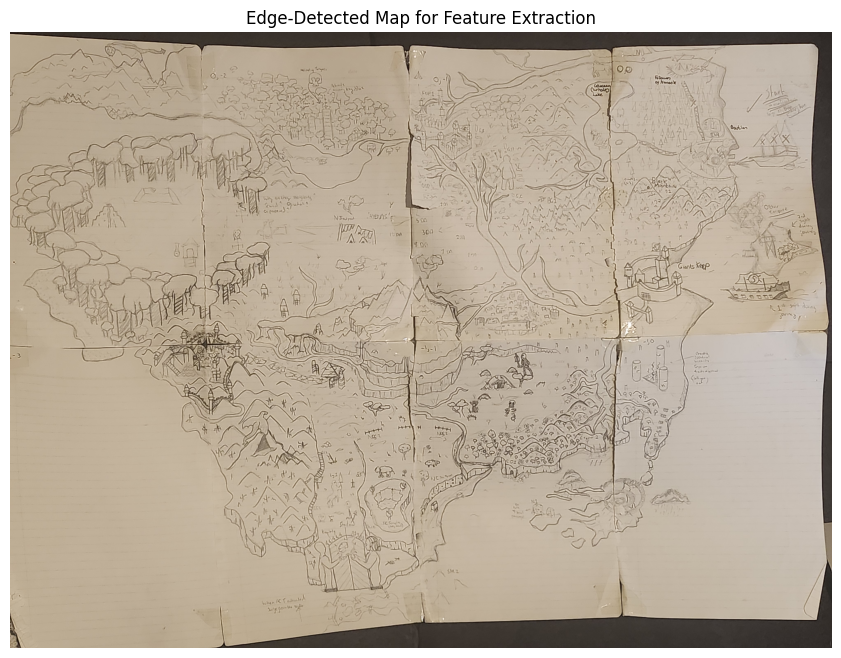

In [ ]:
# Load the uploaded map to analyze it and create a rough digital base
image_path = "newcradle.jpg"
map_image = Image.open(image_path)


# Display the edge-detected version
plt.figure(figsize=(12, 8))
plt.imshow(np.asarray(map_image))
plt.title("Original Image")
plt.axis('off')
plt.show()

## Create Greyscale version

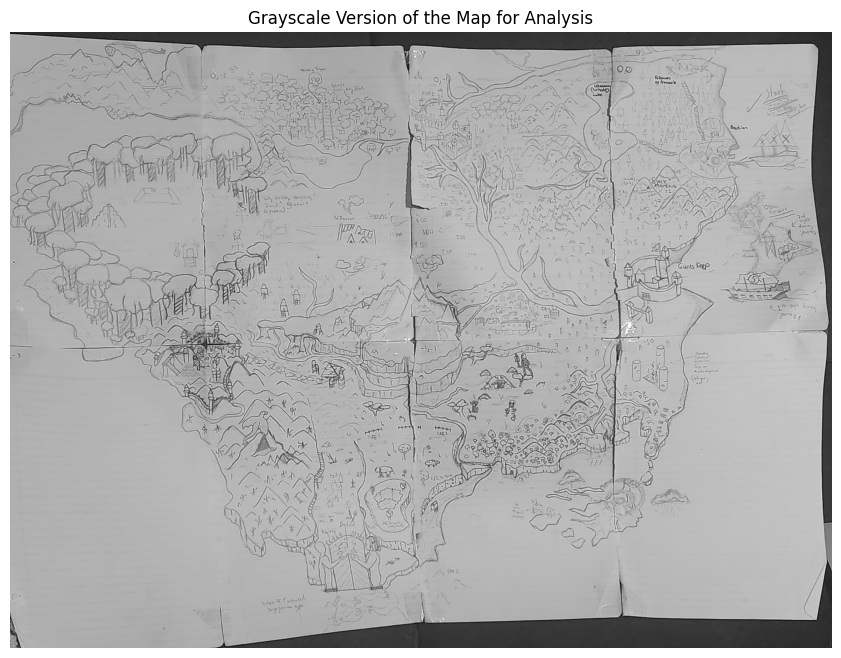

In [9]:
# Convert the image to grayscale for easier feature extraction
map_gray = map_image.convert("L")  # Convert to grayscale

# Display the grayscale version to analyze features
plt.figure(figsize=(12, 8))
plt.imshow(np.asarray(map_gray), cmap='gray')
plt.title("Grayscale Version of the Map for Analysis")
plt.axis('off')
plt.show()



## Get edges

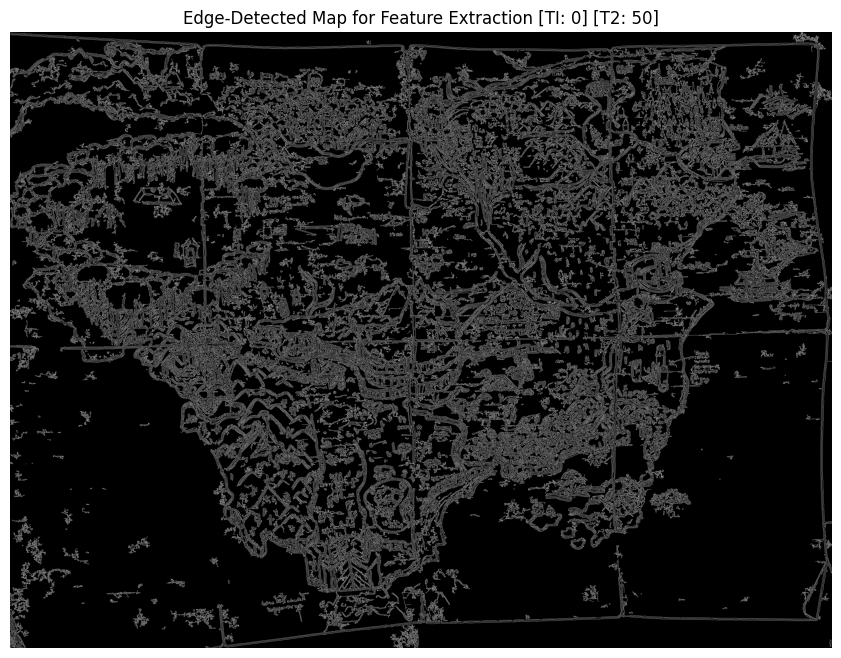

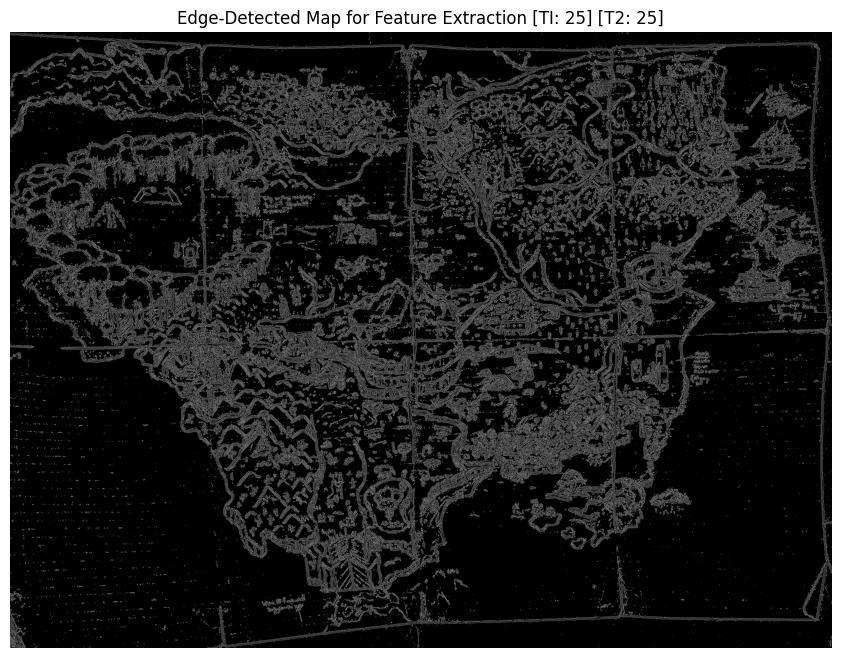

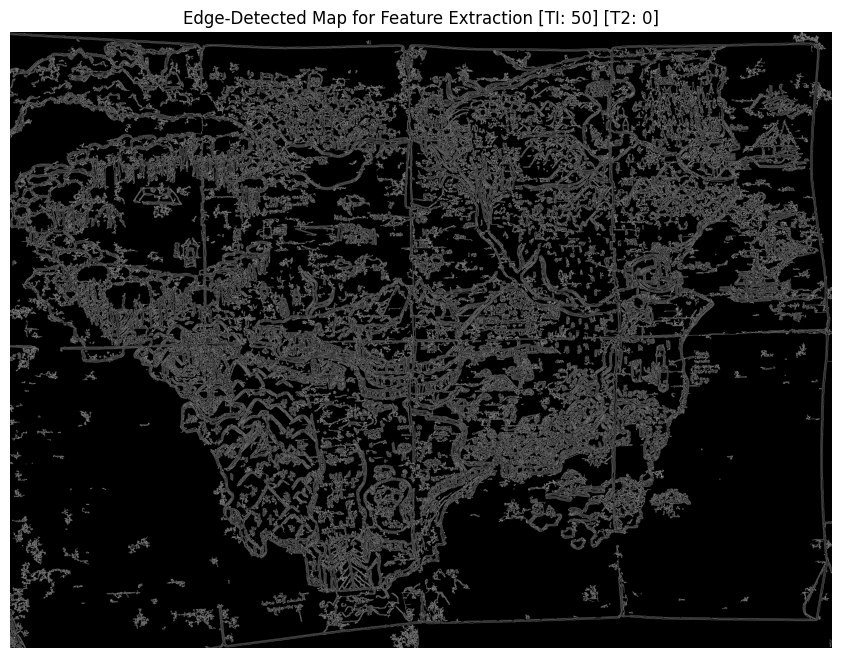

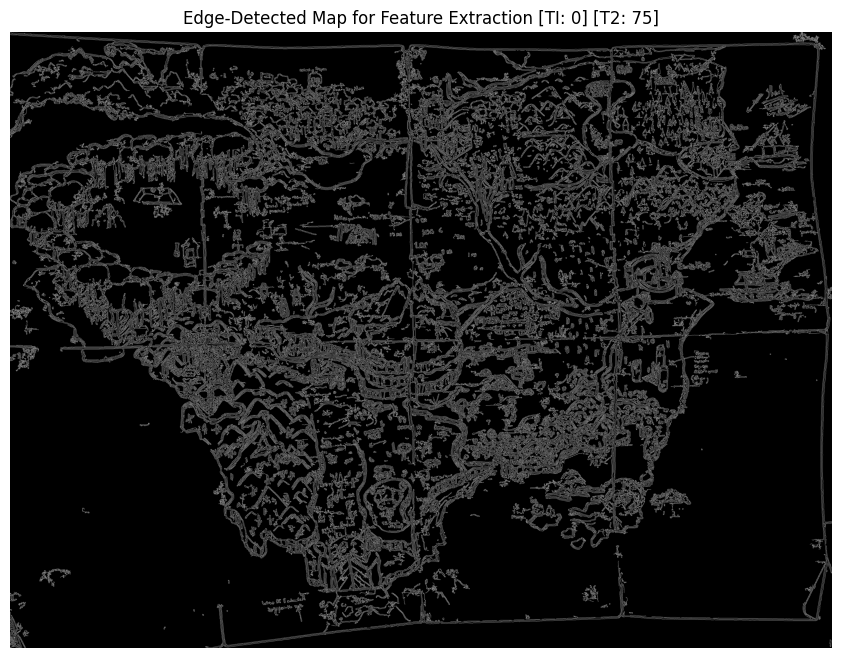

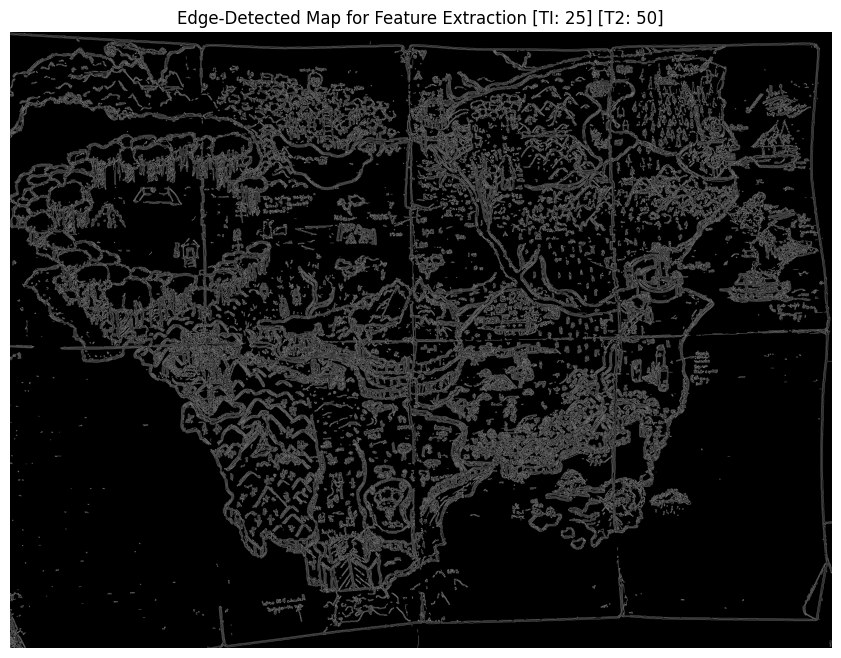

...

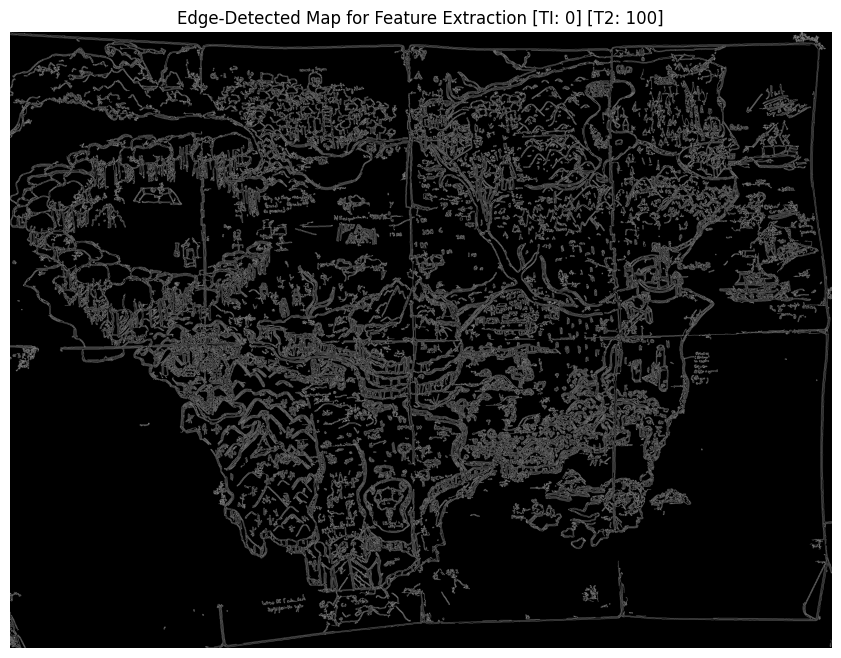

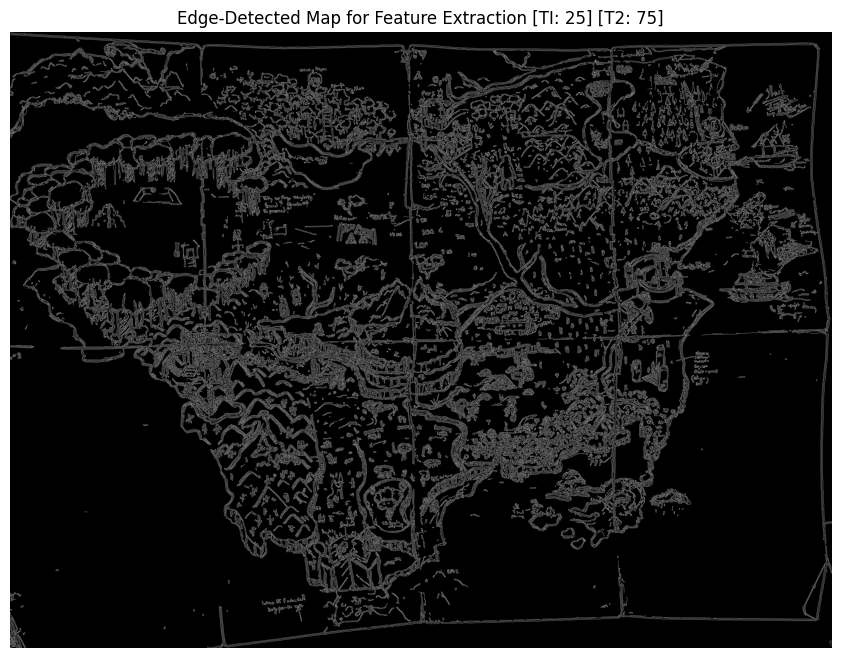

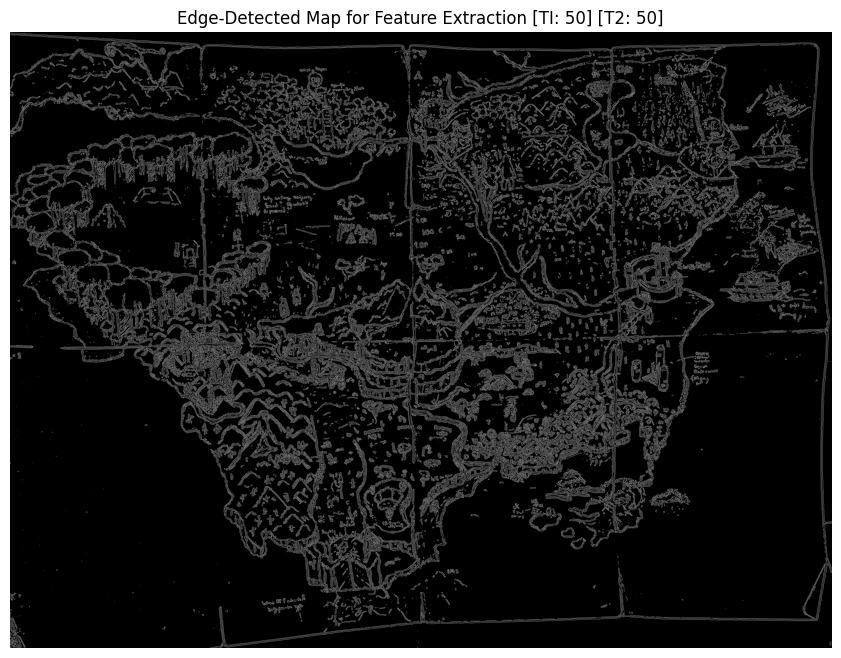

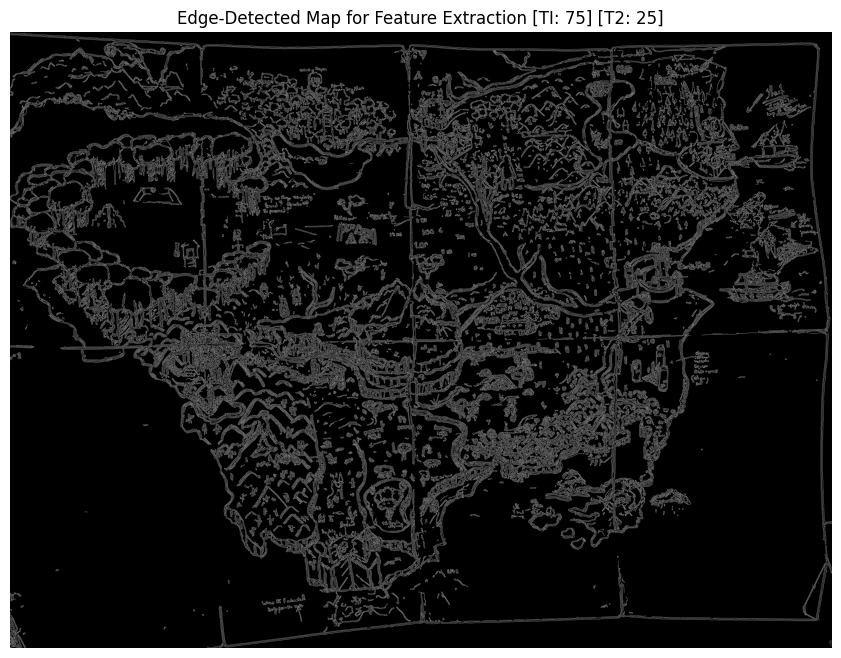

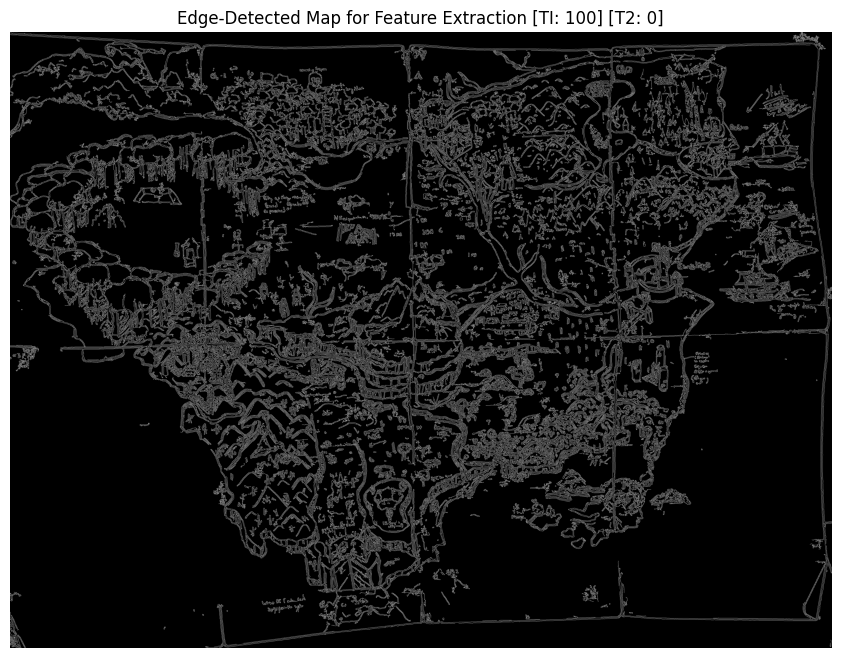

In [45]:

# Convert the grayscale image into an edge-detected version for clearer outlines
map_array = np.asarray(map_gray)

list_edges = [
    (cv2.Canny(map_array, threshold1=t1, threshold2=t2, L2gradient=True), t1, t2)
    for t1 in range(0, 175, 25) for t2 in range(0, 175, 25) if t1 + t2 >= 50 and t1 + t2 <= 100
]
list_edges = sorted(list_edges, key=lambda t: t[1] + t[2])
for edges, t1, t2 in list_edges:
    # Display the edge-detected version
    plt.figure(figsize=(12, 8))
    plt.imshow(edges, cmap='gray')
    plt.title(f"Edge-Detected Map for Feature Extraction [TI: {t1}] [T2: {t2}]")
    plt.axis('off')
    plt.show()


In [46]:
edges_imgs = [edges_image for (edges_image, _, _) in list_edges]

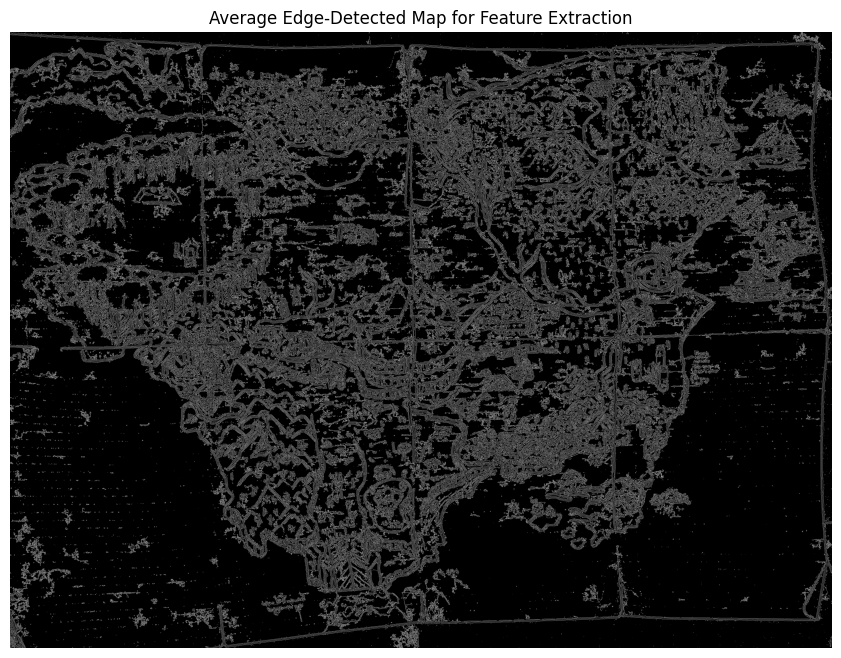

In [47]:

edges_avg = sum(edges_imgs) / len(edges_imgs)
minus_edges = edges_avg
# Display the edge-detected version
plt.figure(figsize=(12, 8))
plt.imshow(minus_edges, cmap='gray')
plt.title(f"Average Edge-Detected Map for Feature Extraction")
plt.axis('off')
plt.show()

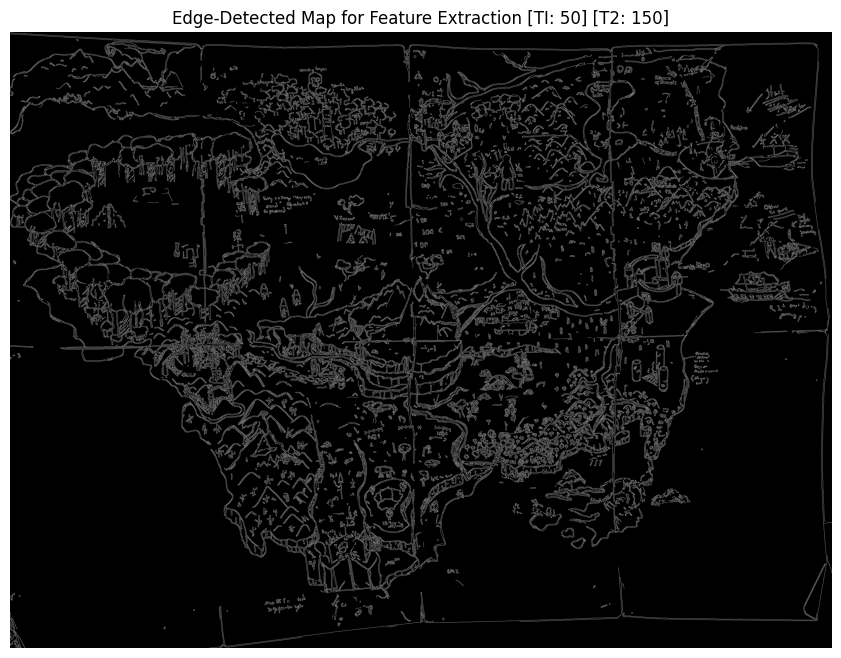

In [51]:
t1, t2 =  50, 150
edges = cv2.Canny(map_array, threshold1=t1, threshold2=t2, L2gradient=True, apertureSize=3)
# Display the edge-detected version
plt.figure(figsize=(12, 8))
plt.imshow(edges, cmap='gray')
plt.title(f"Edge-Detected Map for Feature Extraction [TI: {t1}] [T2: {t2}]")
plt.axis('off')
plt.show()

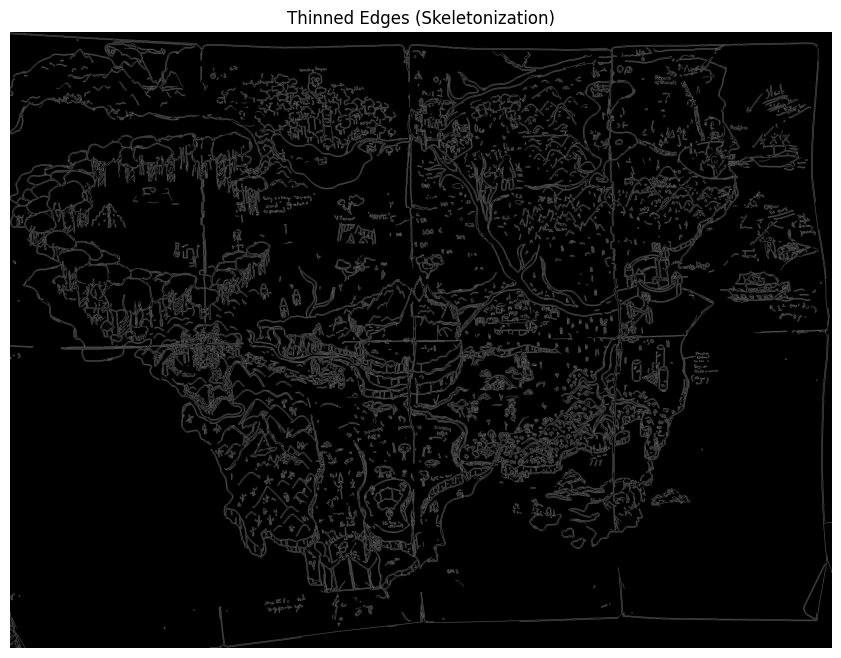

In [58]:
from skimage.morphology import skeletonize

# Skeletonize the edge-detected image
skeletonize_edges = skeletonize(edges / 255).astype(np.uint8) * 255

# Display the thinned edges
plt.figure(figsize=(12, 8))
plt.imshow(skeletonize_edges, cmap='gray')
plt.title("Thinned Edges (Skeletonization)")
plt.axis('off')
plt.show()


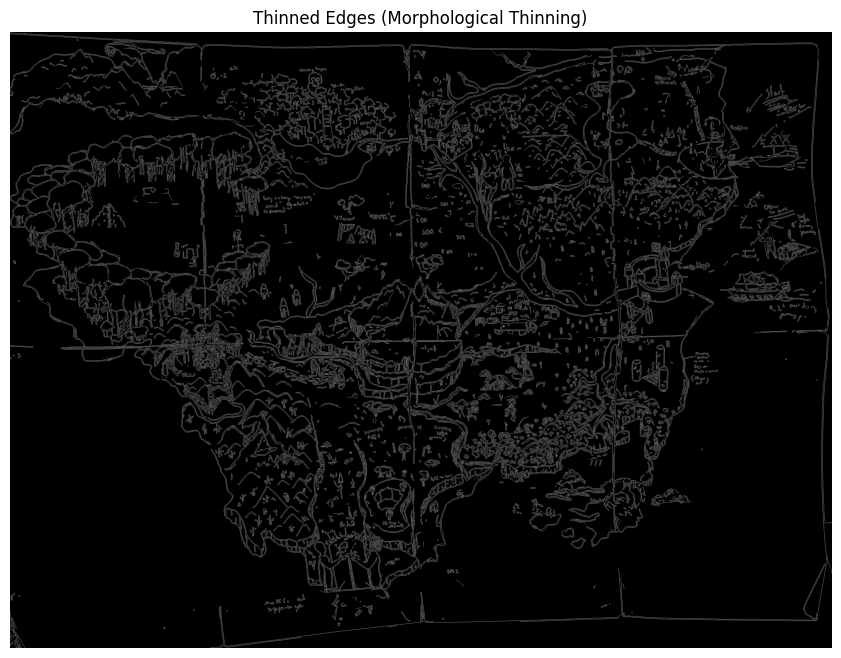

In [54]:
from skimage.morphology import thin

# Thinning the edges
thinned_edges = thin(edges / 255).astype(np.uint8) * 255

# Display the thinned edges
plt.figure(figsize=(12, 8))
plt.imshow(thinned_edges, cmap='gray')
plt.title("Thinned Edges (Morphological Thinning)")
plt.axis('off')
plt.show()


In [70]:
skeletonize_edges.shape, np.zeros(thinned_edges.shape).shape

((3000, 4000), (3000, 4000))

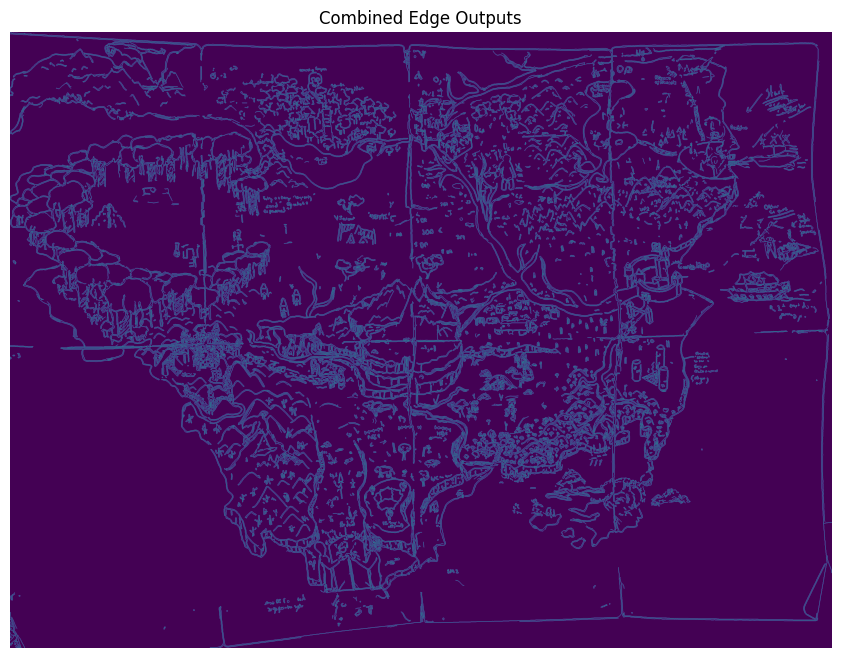

In [ ]:
combined_image = cv2.addWeighted(thinned_edges, 0.5, skeletonize_edges, 0.5, 0)
combined_image = cv2.normalize(combined_image, None, 0, 255, cv2.NORM_MINMAX)
plt.figure(figsize=(12, 8))
plt.imshow(combined_image)
plt.title("Combined Edge Outputs")
plt.axis('off')
plt.show()

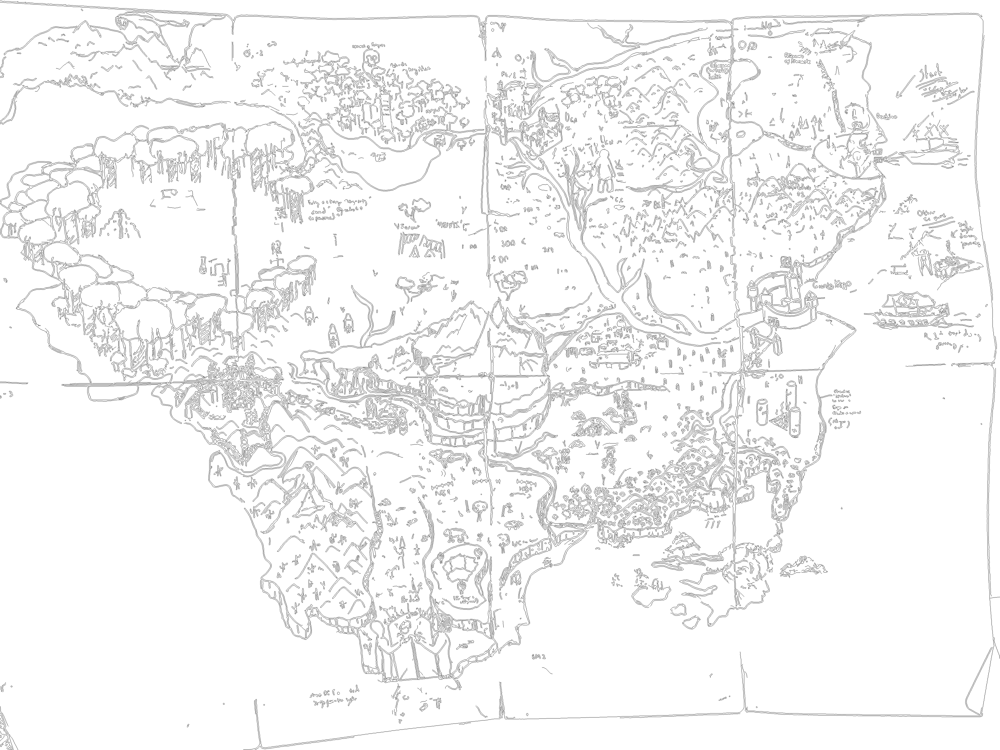

In [109]:
final_image = Image.fromarray(255 - combined_image)
final_image

In [110]:
final_image.save("output_white_black.jpg")

In [114]:
from PIL import ImageOps

# Convert the image to RGBA mode
rgba_image = Image.fromarray(combined_image).convert("RGBA")

# Save the result to a new file
rgba_image.save("output_black_white.png")
rgba_image


# Create a new image with alpha channel based on white pixels
data = rgba_image.getdata()
new_data = []

for item in data:
    # If pixel is white (255, 255, 255), make it transparent (255, 255, 255, 0)
    if item[:3] == (0, 0, 0):
        new_data.append((0, 0, 0, 0))
    else:
        new_data.append((255, 255, 255, item[3]))

# rgba_image = 
# Apply the new data to the image
rgba_image.putdata(new_data)


# Convert to RGB (this discards the alpha channel)
rgb_image = rgba_image.convert("RGB")

# Invert the RGB image
inverted_image = ImageOps.invert(rgb_image)

# Extract the original alpha channel
alpha_channel = rgba_image.getchannel('A')

# Combine the inverted RGB image with the original alpha channel
final_image = Image.merge("RGBA", (inverted_image.split() + (alpha_channel,)))


# Save the output
final_image.save('output_alpha_black.png')



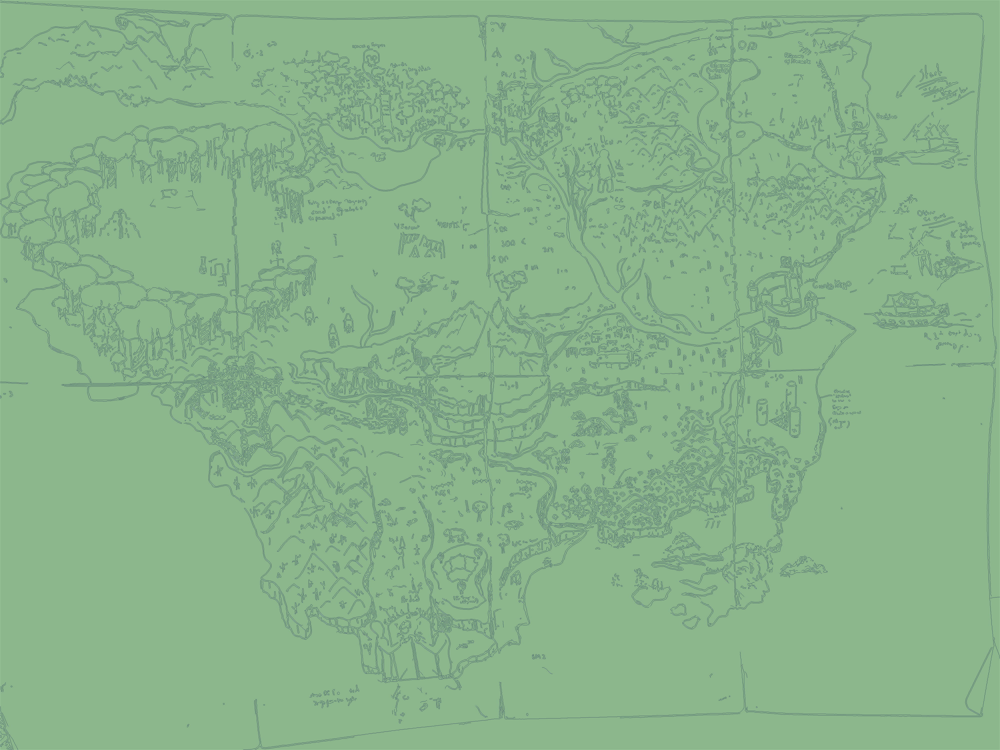

In [113]:
from PIL import Image, ImageDraw, ImageFilter
import numpy as np

# Step 1: Load the edge-detected image
image_path = "output.jpg"  # Replace with your path
edge_map = Image.open(image_path).convert("RGB")

# Step 2: Prepare a blank canvas for coloring
canvas = Image.new("RGB", edge_map.size, "white")
draw = ImageDraw.Draw(canvas)

# Step 3: Create masks for coloring different regions
# Convert edge map to grayscale and detect regions
gray_map = edge_map.convert("L")
pixels = np.array(gray_map)

# Detect enclosed regions (for simplicity, assume we have forest/mountain/water areas)
forest_mask = (pixels > 200)  # Example mask logic for forests
mountain_mask = (pixels > 150) & (pixels <= 200)  # Example mask for mountains
water_mask = (pixels <= 150)  # Example mask for water

# Apply colors based on masks
colored_pixels = np.zeros((pixels.shape[0], pixels.shape[1], 3), dtype=np.uint8)
colored_pixels[forest_mask] = [34, 139, 34]  # Forest green
colored_pixels[mountain_mask] = [139, 69, 19]  # Brown for mountains
colored_pixels[water_mask] = [70, 130, 180]  # Blue for water

# Step 4: Convert back to an image
colored_image = Image.fromarray(colored_pixels)

# Step 5: Overlay the edge map for a hand-drawn effect
overlay = Image.blend(colored_image, edge_map, alpha=0.5)

# Step 6: Add texture
texture = Image.new("RGB", canvas.size, (255, 255, 255))  # Placeholder for a texture
texture = texture.filter(ImageFilter.EMBOSS)  # Embossed texture
final_map = Image.blend(overlay, texture, alpha=0.2)

# Save the final fantasy-style map
final_map.save("fantasy_map.jpg")
final_map.show()
final_map

